In [80]:
from dotenv import find_dotenv, load_dotenv
import os
import pandas as pd
import numpy as np
import networkx as nx
from matplotlib import pyplot as plt
import altair as alt
import sys
import tweepy
import EoN
sys.path.append("../src/features/")
from graph_embed import GraphEmbed
sys.path.append("../src/models/")
from cluster_graphs import ClusterGraphs
sys.path.append("../src/visualization/")
from visualize import Visualize
load_dotenv(find_dotenv())

True

In [3]:
auth = tweepy.OAuthHandler(os.environ['APIKEY'], os.environ["APISECRETKEY"])
auth.set_access_token(os.environ['ACCESSTOKEN'], os.environ['ACCESSTOKENSECRET'])
api = tweepy.API(auth)

In [81]:
clusters = pd.read_pickle("../models/graphs_clustered.pkl")
raw_networks = pd.read_csv("../data/raw/all_networks.csv")
graphs = GraphEmbed.read_graphs(clusters)
viz = Visualize(clusters, graphs)

In [82]:
clust1 = clusters.loc[clusters.label == 1]
clust2 = clusters.loc[clusters.label == 2]
clust0 = clusters.loc[clusters.label == 0]

## Looking for features to be extracted

In [83]:
test_id = 2550402
test_network = raw_networks.loc[raw_networks.id == test_id]
test_g = graphs[test_id]

In [84]:
test_network.iloc[0]

canonical_url            https://wattsupwiththat.com/2021/08/04/gratitu...
date_published                                    2021-08-05T05:00:00.000Z
domain                                                 wattsupwiththat.com
from_user_id                                                      71869296
from_user_screen_name                                      wattsupwiththat
id                                                                 2550402
is_mention                                                           False
site_type                                                            claim
title                    Gratitude for CO2: It Continues to Feed the World
to_user_id                                                        26036200
to_user_screen_name                                        ClimateRealists
tweet_created_at                                  2021-08-05T05:54:32.000Z
tweet_id                                               1423160474867322880
tweet_type               

## Number of Clusters

Chose 3 clusters based on the elbow plot

In [85]:
cl = ClusterGraphs(clusters)
num_clusters, inertias = cl.choose_clust_num_k_means()

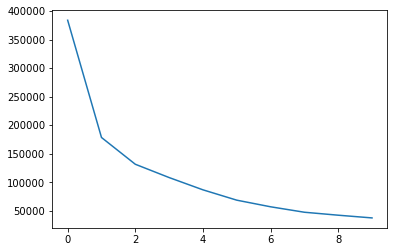

In [86]:
plt.plot(inertias)

In [87]:
num_clusters

3

## Data Summary

In [88]:
# 760 total graphs
len(clusters)

569

In [89]:
clusters.label.value_counts()

0    236
2    195
1    138
Name: label, dtype: int64

In [90]:
clusters.domain.nunique()

57

In [91]:
clusters.domain.value_counts()

trendingpolitics.com          44
swarajyamag.com               33
gnews.org                     30
zerohedge.com                 28
childrenshealthdefense.org    27
washingtontimes.com           26
wattsupwiththat.com           22
prageru.com                   22
everytown.org                 20
churchmilitant.com            20
frontpagemag.com              19
rt.com                        18
toddstarnes.com               16
blacklistednews.com           15
thelibertydaily.com           15
infowars.com                  14
townhall.com                  14
peta.org                      14
quillette.com                 14
cnsnews.com                   14
greenpeace.org                13
bigleaguepolitics.com         11
democrats.org                 11
projectveritas.com             9
indiatimes.com                 9
gulfnews.com                   8
mindbodygreen.com              8
thehighwire.com                8
americanthinker.com            7
globaltimes.cn                 7
worldstarh

In [92]:
clusters.describe()

,id,total_time,retweet_num,quote_num,reply_num,origin_num,article_pol,article_subjectivity,care_sent,fairness_sent,...,largest_wcc,diameter_largest_wcc,max_out_degree,max_in_degree,mean_out_degree,mean_in_degree,average_time,reproduction_num,wiener_index,label
count,5.690000e+02,5.690000e+02,569.000000,569.000000,569.000000,569.000000,568.000000,568.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,5.690000e+02,569.000000,569.000000,569.000000
mean,2.638397e+06,1.191503e+06,0.705004,0.102317,0.120432,0.072247,0.015730,0.181916,-0.127973,-0.089644,...,0.807329,2.478032,10.249561,1.467487,0.868241,0.868241,8.041242e+04,2.120657,10.092988,0.927944
std,8.856133e+04,2.836234e+06,0.312940,0.156986,0.266645,0.179095,0.205058,0.271010,0.173005,0.173526,...,0.252383,0.787194,7.634540,1.407755,0.126479,0.126479,2.196933e+05,1.736084,9.527358,0.868102
min,2.543965e+06,0.000000e+00,0.000000,0.000000,0.000000,0.000000,-1.000000,0.000000,-0.698362,-0.844200,...,0.096774,1.000000,1.000000,1.000000,0.533333,0.533333,0.000000e+00,0.062500,0.055556,0.000000
25%,2.579977e+06,4.057600e+04,0.571429,0.000000,0.000000,0.000000,0.000000,0.000000,-0.224609,-0.184434,...,0.636364,2.000000,5.000000,1.000000,0.800000,0.800000,3.024100e+03,1.000000,4.166667,0.000000
50%,2.591471e+06,1.115660e+05,0.833333,0.042553,0.000000,0.000000,0.000000,0.000000,-0.113381,-0.069831,...,1.000000,2.000000,8.000000,1.000000,0.882353,0.882353,8.335111e+03,1.611111,7.111111,1.000000
75%,2.664231e+06,4.964390e+05,0.944444,0.142857,0.037037,0.062500,0.000000,0.338462,0.000000,0.000000,...,1.000000,3.000000,13.000000,1.000000,0.925926,0.925926,2.925093e+04,2.743590,12.857143,2.000000
max,2.887568e+06,1.574560e+07,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.587559,0.528279,...,1.000000,6.000000,44.000000,16.000000,2.250000,2.250000,1.868676e+06,11.011111,57.297297,2.000000


## Exploring Differences between Clusters

In [93]:
viz.plot_cluster_size()

alt.Chart(...)

### Graphs closest to cluster centroids

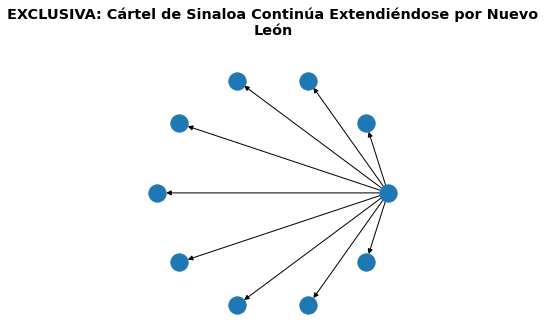

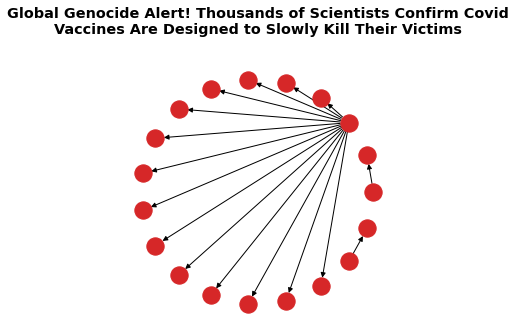

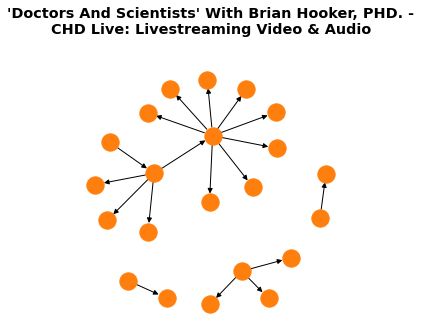

In [94]:
viz.viz_graphs(clusters.loc[clusters.is_mean_vec == True].id.to_list())

### Statistical Differences between clusters

In [95]:
viz.graph_point_range_cluster_info(True, {"num_nodes": "Number of Nodes"}, 200, 250, 3)

alt.FacetChart(...)

In [96]:
viz.graph_point_range_cluster_info(True, {"num_edges": "Number of Edges"}, 200, 250, 3)

alt.FacetChart(...)

In [97]:
viz.graph_point_range_cluster_info(True, {"num_wcc": "Number of Components"}, 200, 250, 1)

alt.FacetChart(...)

In [98]:
viz.graph_point_range_cluster_info(True, {'largest_wcc': "Largest Component"}, 200, 250, 3)

alt.FacetChart(...)

In [99]:
viz.graph_point_range_cluster_info(True, {'total_time': "Total Time"}, 200, 250, 3)

alt.FacetChart(...)

In [100]:
viz.graph_point_range_cluster_info(True, {'average_time': "Average Time"}, 200, 250, 3)

alt.FacetChart(...)

In [101]:
viz.graph_point_range_cluster_info(False, ['diameter_largest_wcc'], 200, 250, 3)

alt.FacetChart(...)

In [102]:
viz.graph_point_range_cluster_info(False, ['max_out_degree'], 200, 250, 3)

alt.FacetChart(...)

In [103]:
viz.graph_point_range_cluster_info(False, ['max_in_degree'], 200, 250, 3)

alt.FacetChart(...)

In [104]:
viz.graph_point_range_cluster_info(False, ['mean_out_degree', "mean_in_degree"], 200, 250, 3)

alt.FacetChart(...)

In [105]:
viz.graph_point_range_cluster_info(False, ['reply_num', "quote_num", "origin_num"], 200, 250, 3)

alt.FacetChart(...)

In [106]:
viz.graph_point_range_cluster_info(False, ['retweet_num'], 200, 250, 3)

alt.FacetChart(...)

In [107]:
viz.graph_point_range_cluster_info(False, ['reproduction_num'], 200, 250, 3)

alt.FacetChart(...)

In [108]:
viz.graph_point_range_cluster_info(False, ['article_pol'], 200, 250, 3)

alt.FacetChart(...)

In [109]:
viz.graph_point_range_cluster_info(False, ['article_subjectivity'], 200, 250, 3)

alt.FacetChart(...)

In [110]:
viz.graph_point_range_cluster_info(False, ['wiener_index'], 200, 250, 3)

alt.FacetChart(...)

In [119]:
viz.graph_point_range_cluster_info(False, ['care_sent', 'fairness_sent', 'loyalty_sent', 'authority_sent', 'sanctity_sent'], 200, 250, 3)

alt.FacetChart(...)

### Most Popular Domains Clusters

In [111]:
viz.viz_type_clusters("domain")

alt.Chart(...)

### Article languages within each cluster

In [112]:
viz.viz_type_clusters("article_lang")

alt.Chart(...)

### Features Correlation

<AxesSubplot:>

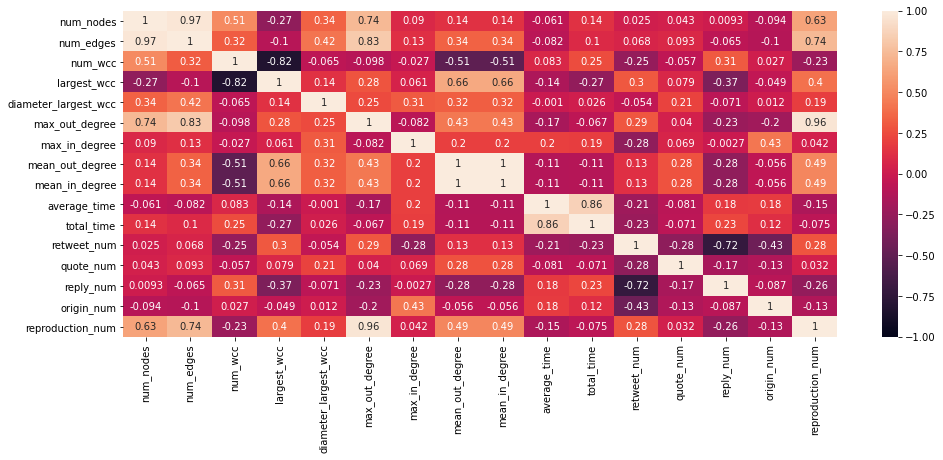

In [113]:
viz.get_corr_heat_map(["num_nodes", "num_edges", "num_wcc", "largest_wcc", "diameter_largest_wcc", "max_out_degree", "max_in_degree", "mean_out_degree", "mean_in_degree", "average_time", "total_time", "retweet_num", "quote_num","reply_num","origin_num", "reproduction_num"])

## Visualizing principal components

In [114]:
p_components = viz.graph_reduced_dimensions(["id", "num_nodes", "title"], 400, 400, "How Diffusion Networks Vary")
p_components

alt.Chart(...)

## looking at random diffusion networks

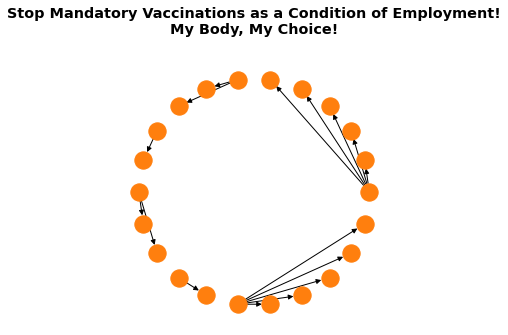

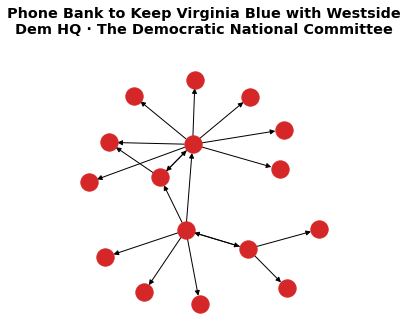

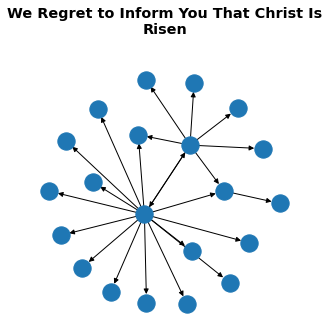

In [115]:
ids = [clust0.sample(1).id.values[0], clust1.sample(1).id.values[0], clust2.sample(1).id.values[0]]
viz.viz_graphs(ids)

## Investigating Origin Tweet type and max in degree of all graphs

It looks like in this case it was a bunch of people that all replied/retweeted Peta

In [116]:
test_id = clusters.loc[clusters.max_in_degree.idxmax()].id
test_graph = graphs[test_id]

In [117]:
in_network = raw_networks.loc[raw_networks.id == test_id]
tweet_ids = in_network.tweet_id.to_list()

In [118]:
tweet = api.get_status(tweet_ids[10])
tweet.text

NameError: name 'api' is not defined